In [1]:
import numpy as np
from mtcnn import MTCNN
from PIL import Image, ImageDraw
from matplotlib import pyplot as plt

In [2]:
detector = MTCNN()

In [3]:
image = Image.open("../images/sample_1.jpg")

In [4]:
faces = detector.detect_faces(np.array(image))

3/3 [==============================] - 0s 15ms/step


In [5]:
def extractFaces(image: Image, faces):
    output = []
    
    for face in faces:
        x, y, w, h = face['box']
        output.append(image.crop((x, y, x + w, y + h)))
        
    return output

In [6]:
def drawBoundingBoxes(image: Image, faces):
    tmp = image.copy()
    draw = ImageDraw.Draw(tmp)
    for face in faces:
        x, y, w, h = face['box']
        
        draw.rectangle((x, y, x + w, y + h), outline="red", width=2)
        
    return tmp

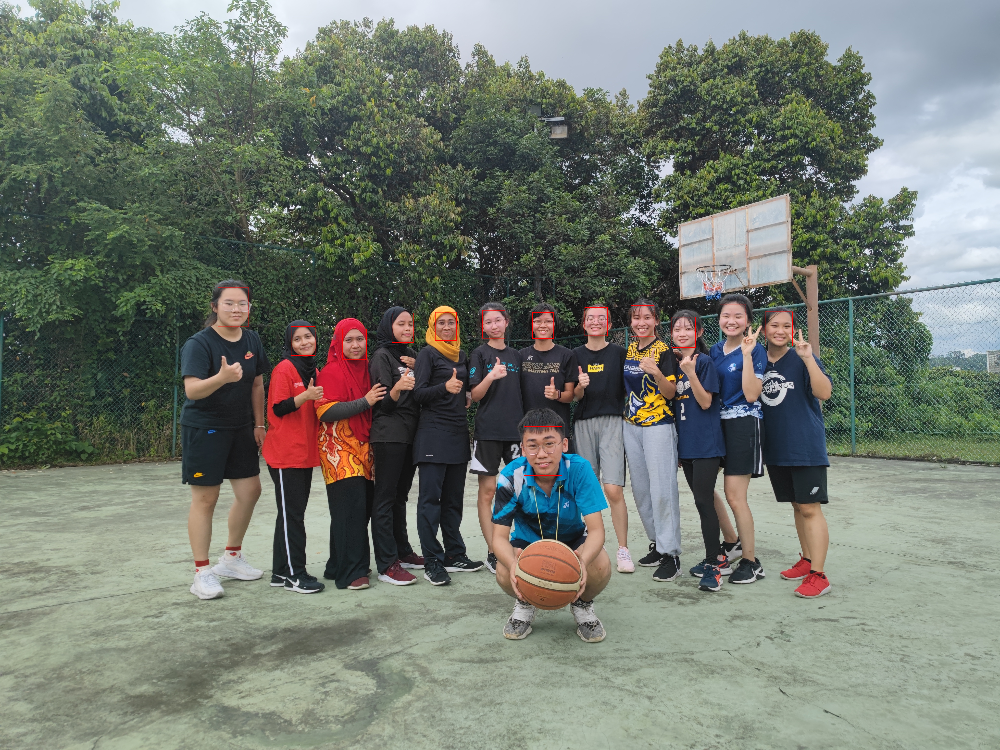

In [8]:
drawBoundingBoxes(image, faces)

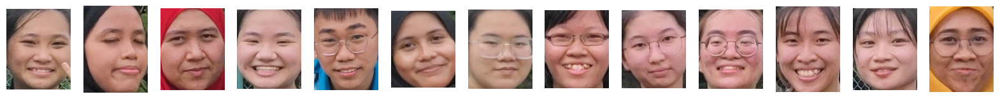

In [7]:
cropped_faces = extractFaces(image, faces)

plt.subplots(1, len(cropped_faces), figsize=(20, 20))

for i, face in enumerate(cropped_faces):
    plt.subplot(1, len(cropped_faces), i+1)
    plt.imshow(face)
    plt.axis('off')

In [9]:
sorted(faces, key=lambda x: x['confidence'], reverse=True)

[{'box': [3121, 1271, 112, 141],
  'confidence': 0.9999994039535522,
  'keypoints': {'left_eye': (3161, 1328),
   'right_eye': (3211, 1332),
   'nose': (3187, 1360),
   'mouth_left': (3155, 1375),
   'mouth_right': (3207, 1379)}},
 {'box': [1599, 1276, 89, 121],
  'confidence': 0.9999991655349731,
  'keypoints': {'left_eye': (1639, 1322),
   'right_eye': (1678, 1324),
   'nose': (1670, 1341),
   'mouth_left': (1639, 1365),
   'mouth_right': (1676, 1365)}},
 {'box': [1397, 1341, 98, 125],
  'confidence': 0.9999946355819702,
  'keypoints': {'left_eye': (1423, 1390),
   'right_eye': (1468, 1385),
   'nose': (1450, 1415),
   'mouth_left': (1431, 1437),
   'mouth_right': (1471, 1433)}},
 {'box': [2937, 1240, 106, 131],
  'confidence': 0.9999819993972778,
  'keypoints': {'left_eye': (2964, 1293),
   'right_eye': (3013, 1294),
   'nose': (2984, 1319),
   'mouth_left': (2961, 1334),
   'mouth_right': (3014, 1336)}},
 {'box': [2137, 1739, 156, 201],
  'confidence': 0.99996018409729,
  'keypoint